<a href="https://colab.research.google.com/github/vsermoud/Introduction-to-Classical-DFT/blob/main/Implementing_the_FMT_in_Real_and_Fourier_space_(1D_Approach).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Hard-Sphere Fluid and the Fundamental Measure Theory

### With the addition of the hard-sphere term, the cDFT equation must be written in the traditional form, with the contribution of the excess free energy.

### $\rho(r) = \rho_b \exp \left( \frac{\mu_{exc}}{k_BT} - \frac{V_{ext}(r)}{k_BT} - \frac{1}{k_BT}\frac{\delta F_{hs}}{\delta \rho(r)}  \right)$

## The Fundamental Measure Theory

### The excess free energy can be described using the modified fundamental measure theory (FMT) to model the contribution of hard-spheres repulsion.

### $F_{hs} = k_BT\int \Phi^{hs}[n_\alpha(r)] \text{d}r$

### There are some formulations to describe Fhs, which are calculated from some thermodynamic conditions. Yu and Wu separated  into two terms, one considering the contribution of solely scalar terms $\phi_{sc}$ and the other considering vector terms $\phi_{vec}$,

Yu, Yang-Xin, and Jianzhong Wu. "Structures of hard-sphere fluids from a modified fundamental-measure theory." The Journal of chemical physics 117.22 (2002): 10156-10164.

### $\Phi_{hs} = \Phi^{sc}+ \Phi^{vec}$

### $\Phi^{sc} = -n_0 \ln{(1-n_3)}+ \frac{n_1n_2}{1-n_3}+n_2^3 \left( \frac{1}{36\pi(1-n_3)^2}+ \frac{\ln(1-n_3)}{36\pi n_3^2} \right) \\
\Phi^{vec} = -\frac{\textbf{n}_1\textbf{n}_2}{(1-n_3)} - n_2\textbf{n}_2 \cdot \textbf{n}_2 \left( \frac{1}{ 12 \pi(1-n_3)^2} + \frac{\ln (1-n_3)}{12 \pi n_3^2} \right)$

### In which,

### $n_\alpha(r) = \int \rho(r') \omega_\alpha(r-r') dr'$

### where $\alpha = 0, 1, 2, 3, V_1, V_2$ :

### $\omega^{(3)}(r) = \Theta\left(\frac{\sigma}{2}-r\right)\\
\omega^{(2)}(r) = \delta\left(\frac{\sigma}{2}-r\right)\\
\omega^{(V_2)}(r) = \frac{\textbf{r}}{r}\delta\left(\frac{\sigma}{2}-r\right)\\
\omega^{(0)}(r) = \frac{\delta\left(\frac{\sigma}{2}-r\right)}{4\pi R^2} = \frac{\omega^{(2)}(r)}{4\pi R^2}\\
\omega^{(1)}(r) = \frac{\delta\left(\frac{\sigma}{2}-r\right)}{4\pi R} = \frac{\omega^{(2)}(r)}{4\pi R}\\
\omega^{(V_1)}(r) = \frac{\textbf{r}}{r}\frac{\delta\left(\frac{\sigma}{2}-r\right)}{4\pi R} = \frac{\omega^{(V_2)}(r)}{4\pi R}$

### First: Heaviside step function:

### $\begin{align}
\Theta(x) = 1& \;, &\text{if}\; &x > 0&\\
             0& \;, &\text{if}\; &x \leq0&.
\end{align}$

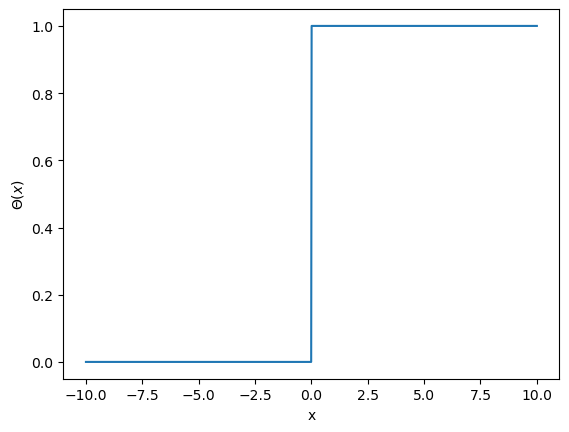

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

x = np.linspace(-10,10,1000)
theta = np.heaviside(x,1)

plt.plot(x,theta)
plt.xlabel("x")
plt.ylabel(r"$\Theta(x)$")
plt.show()

### On the calculation of the weighting functions, the Heaviside function is evaluated concerning $\frac{\sigma}{2}-r$.

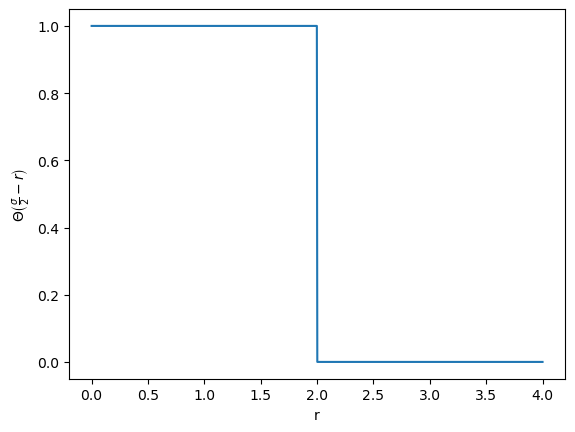

In [ ]:
import numpy as np
from matplotlib import pyplot as plt


#grid points
npoints = 1000

#Molecule radius
Sigma = 4

#space vector
r = np.linspace(0,4,npoints)

#Input of the Heaviside function
x = np.zeros((npoints))
for i in range(1000):
    x[i] = 0.5*Sigma - r[i]

#Heaviside Function
theta = np.heaviside(x,1)


plt.plot(r,theta)
plt.xlabel("r")
plt.ylabel(r"$\Theta\left(\frac{\sigma}{2}-r\right)$")
plt.show()

### Thus the Heaviside function will be 1 for every point inside the molecule radius limits, while it is zero when it is outside the molecule limit.

In [ ]:
import plotly
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
#Jupyter setup
init_notebook_mode(connected=True)
import plotly.graph_objects as go
import numpy as np


Nump = 40 #number point

x = np.linspace(0,10,Nump)
y = np.linspace(0,10,Nump)
z = np.linspace(0,10,Nump)

X,Y,Z = np.meshgrid(x,y,z) # mesh

Raio_esf = 5
center = [5,5,5]
Theta = np.zeros((Nump,Nump,Nump))

for i in range(Nump):
    for j in range(Nump):
        for k in range(Nump):
            dist = np.sqrt((x[i]-center[0])**2+(y[j]-center[1])**2+(z[k]-center[2])**2)
            if Raio_esf-dist > 0:
                Theta[i,j,k] = 1
            else:
                Theta[i,j,k] = 0


fig = go.Figure(data=go.Volume(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value=Theta.flatten(),
    isomin=0,
    isomax=1,
    opacity=0.1,
    surface_count = 10, #number of isosurfaces, 2 by default(min and max)
    colorbar_nticks=5 # colorbar ticks correspond to isosurface values
    #colorscale='RdBu'
    ))

iplot(fig)

### Whith this example it is possible to see that:
    
### $\int \omega^{(3)}\left(\frac{\sigma}{2}-r\right) dr = \int \Theta\left(\frac{\sigma}{2}-r\right) dr = \frac{\pi \sigma^3 }{6}$

In [ ]:
soma = 0
for i in range(Nump):
    for j in range(Nump):
        for k in range(Nump):
            soma += Theta[i,j,k]
soma = soma*(x[1]-x[0])*(y[1]-y[0])*(z[1]-z[0])

print('Volume of the integrated region =', soma)
print('Volume of the Sphere =', np.pi*10**3/6)

Volume of the integrated region = 522.1935636136818
Volume of the Sphere = 523.5987755982989


[!TIP]
#### If you change "Nump" in the code, the resolution of the sphere will change, in the same way that the resolution on DFT calculation can give poor spherical representations.

### Second: Dirac delta function

### $\delta(x) = \frac{\text{d}}{\text{d}x}\Theta(x)$

In [ ]:
def ddx(f,x):
    f_x = np.zeros(len(f))
    for i in range(len(f)):
        h = x[1]-x[0]
        if i>=1 and i<=len(f)-2:
            f_x[i] = (-1*f[i-1]+0*f[i+0]+1*f[i+1])/(2*1.0*h**1)
        else:
            f_x[i] = 0
    return f_x

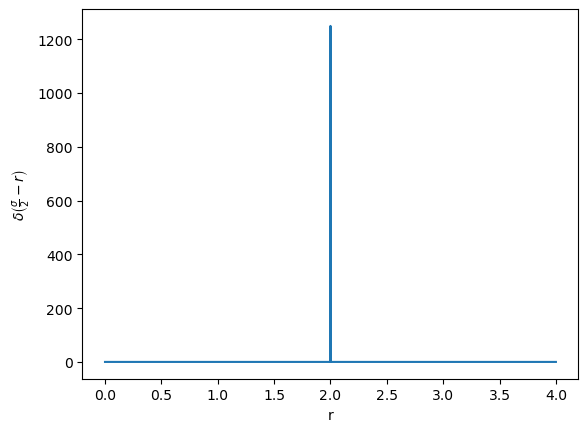

In [ ]:
#grid points
npoints = 10000

#Molecule radius
Sigma = 4

#space vector
r = np.linspace(0,4,npoints)

#Input of the Heaviside function
x = np.zeros((npoints))
for i in range(npoints):
    x[i] = 0.5*Sigma - r[i]

#Heaviside Function
theta = np.heaviside(x,1)

#Dirac Function
Dirac = ddx(theta,x)

plt.plot(r,Dirac)
plt.xlabel("r")
plt.ylabel(r"$\delta\left(\frac{\sigma}{2}-r\right)$")
plt.show()

### What is $\int \delta\left(\frac{\sigma}{2}-r\right)dr ?$

In [ ]:
from scipy import integrate
print(integrate.trapz(Dirac,r))

1.0000000000002776


### The figure below shows a schematic of how the Dirac delta would look in 3D. To make it easier, where the delta would be different from 0, we have set it to 1 and plotted just one octant of the sphere so the surface would be easy to see.

In [ ]:
import plotly.graph_objects as go
import numpy as np


Nump = 50 #number point

xtop = 11
ytop = 11
ztop = 11

x = np.linspace(0,5.5,Nump)#xtop,Nump)
y = np.linspace(0,5.5,Nump)#ytop,Nump)
z = np.linspace(0,5.5,Nump)#ztop,Nump)

X,Y,Z = np.meshgrid(x,y,z) # mesh

Raio_esf = 5
center = [0.5*xtop,0.5*ytop,0.5*ztop]
Theta = np.zeros((Nump,Nump,Nump))

for i in range(Nump):
    for j in range(Nump):
        for k in range(Nump):
            dist = np.sqrt((x[i]-center[0])**2+(y[j]-center[1])**2+(z[k]-center[2])**2)
            if abs(Raio_esf-dist) < (x[1]-x[0]):
                Theta[i,j,k] = 1
            else:
                Theta[i,j,k] = 0


fig = go.Figure(data=go.Volume(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value=Theta.flatten(),
    isomin=0,
    isomax=1,
    opacity=0.1,
    surface_count = 10, #number of isosurfaces, 2 by default(min and max)
    colorbar_nticks=2 # colorbar ticks correspond to isosurface values
    #colorscale='RdBu'
    ))

iplot(fig)

### Considering multiple components in a one-dimensional (1D) system, such as the slit-like pore case, the $n_\alpha$ functionals can be rewritten in the form:

### $n_\alpha(r) = \sum_{i}^{N_c} \int\rho(z')\omega_\alpha(z-z') \text{d}z'$

### These weights will then be presented as their respective functions in real space, for the 1D scenario.

### $\omega_0(z-z') = \frac{\Theta(z-z'+0.5\sigma_i)-\Theta(z-z'-0.5\sigma_i)}{\sigma_i}$

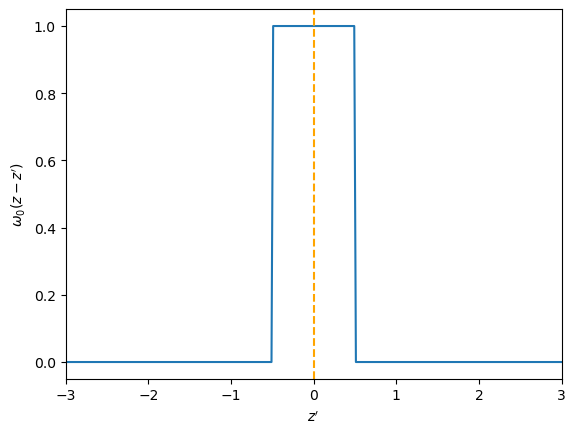

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0


omega0 = (np.heaviside(z-z_line+0.5*sigma,1)-np.heaviside(z-z_line-0.5*sigma,1))/sigma

plt.xlim(-3,3)

plt.plot(z_line,omega0)
plt.axvline(x=z,color='orange',linestyle="--")
plt.xlabel("$z'$")
plt.ylabel(r"$\omega_0(z-z')$")
plt.show()

### $\omega_1(z-z') = \frac{\Theta(z-z'+0.5\sigma_i)-\Theta(z-z'-0.5\sigma_i)}{2}$

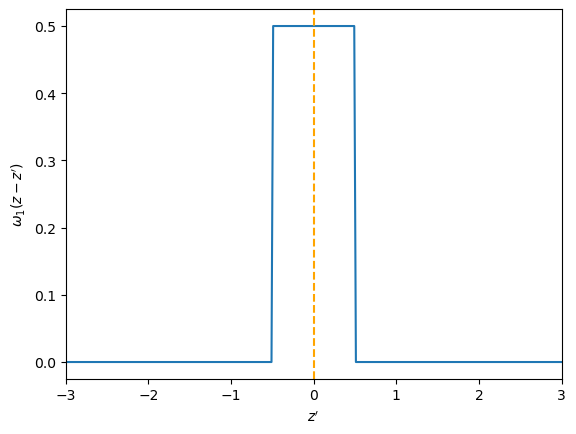

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0

omega0 = (np.heaviside(z-(z_line)+0.5*sigma,1)-np.heaviside(z-(z_line)-0.5*sigma,1))/2

plt.xlim(-3,3)

plt.plot(z_line,omega0)
plt.axvline(x=z,color='orange',linestyle="--")
plt.xlabel("$z'$")
plt.ylabel(r"$\omega_1(z-z')$")
plt.show()

### $\omega_2(z-z') = \pi\sigma\left(\Theta(z-z'+0.5\sigma_i)-\Theta(z-z'-0.5\sigma_i)\right)$

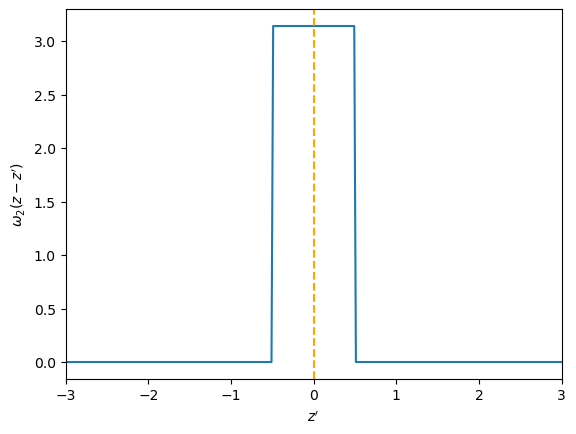

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0

omega0 = (np.heaviside(z-(z_line)+0.5*sigma,1)-np.heaviside(z-(z_line)-0.5*sigma,1))*np.pi*sigma

plt.xlim(-3,3)

plt.plot(z_line,omega0)
plt.axvline(x=z,color='orange',linestyle="--")
plt.xlabel("$z'$")
plt.ylabel(r"$\omega_2(z-z')$")
plt.show()

### $\omega_3(z-z') = \pi\left(\Theta(z-z'+0.5\sigma_i)-\Theta(z-z'-0.5\sigma_i)\right)
\times\left[\left(\frac{\sigma}{2} \right)^2 - (z-z')^2\right]$

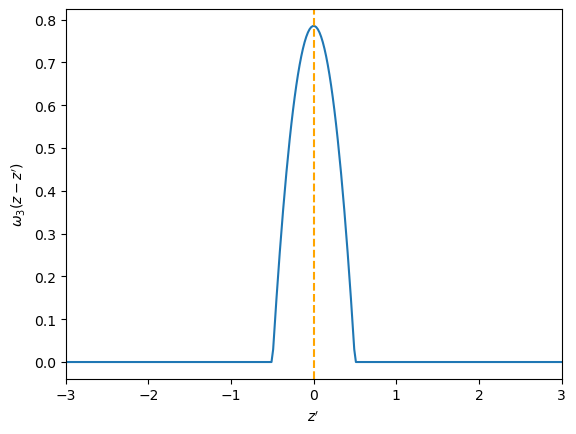

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0

omega0 = (np.heaviside(z-(z_line)+0.5*sigma,1)-np.heaviside(z-(z_line)-0.5*sigma,1))*np.pi*((0.5*sigma)**2-(z-z_line)**2)

plt.xlim(-3,3)

plt.plot(z_line,omega0)
plt.axvline(x=z,color='orange',linestyle="--")
plt.xlabel("$z'$")
plt.ylabel(r"$\omega_3(z-z')$")
plt.show()

### $\omega_{V1}(z-z') = -\hat{e}_z\frac{\left(\Theta(z-z'+0.5\sigma_i)-\Theta(z-z'-0.5\sigma_i)\right)}{\sigma}(z-z')$

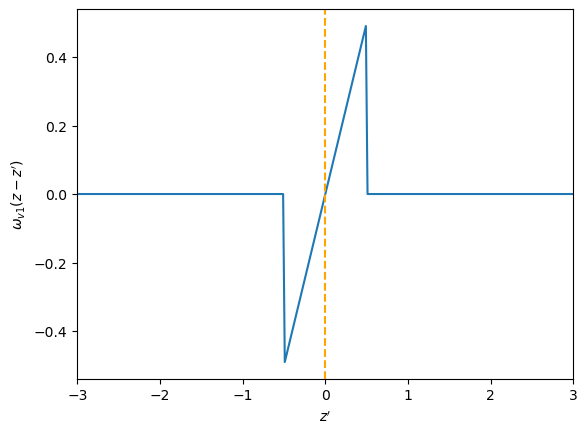

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0

omega0 = -(np.heaviside(z-(z_line)+0.5*sigma,1)-np.heaviside(z-(z_line)-0.5*sigma,1))*(z-z_line)/sigma

plt.xlim(-3,3)

plt.plot(z_line,omega0)
plt.axvline(x=z,color='orange',linestyle="--")
plt.xlabel("$z'$")
plt.ylabel(r"$\omega_{v1}(z-z')$")
plt.show()

### $\omega_{V2}(z-z') = -2\pi\hat{e}_z\left(\Theta(z-z'+0.5\sigma_i)-\Theta(z-z'-0.5\sigma_i)\right)(z-z')$

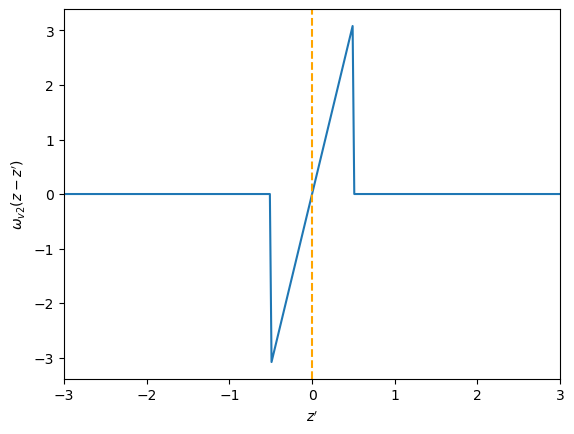

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0

omega0 = -2*np.pi*(np.heaviside(z-(z_line)+0.5*sigma,1)-np.heaviside(z-(z_line)-0.5*sigma,1))*(z-z_line)

plt.xlim(-3,3)

plt.plot(z_line,omega0)
plt.axvline(x=z,color='orange',linestyle="--")
plt.xlabel("$z'$")
plt.ylabel(r"$\omega_{v2}(z-z')$")
plt.show()

### For the 1D case, the weighted density functions can also be written as ($\hat{z} = z'-z $ )

### $n_0(r) = \sum_{i}^{N_c} \frac{1}{\sigma_i}\int_{-0.5\sigma}^{0.5\sigma} \rho(z+\hat{z}) d\hat{z}$
### $n_1(r) = \sum_{i}^{N_c} 0.5 \int_{-0.5\sigma}^{0.5\sigma} \rho(z+\hat{z}) d\hat{z}$
### $n_2(r) = \sum_{i}^{N_c} \pi \sigma_i \int_{-0.5\sigma}^{0.5\sigma} \rho(z+\hat{z}) d\hat{z}$
### $n_3(r) = \sum_{i}^{N_c} \pi \int_{-0.5\sigma}^{0.5\sigma} \rho(z+\hat{z}) \left[ \left(\frac{\sigma_i}{2} \right)^2 - \hat{z}^2\right]d\hat{z}$
### $ \textbf{n}_1(r) = - \textbf{e}_z \sum_{i}^{N_c} \frac{1}{\sigma_i} \int_{-0.5\sigma}^{0.5\sigma} \rho(z+\hat{z}) \hat{z}d\hat{z}$
### $ \textbf{n}_2(r) = - \textbf{e}_z \sum_{i}^{N_c} 2\pi \int_{-0.5\sigma}^{0.5\sigma} \rho(z+\hat{z}) \hat{z}d\hat{z}$

### Knowing how to calculate the weighted density functions, it is necessary to solve the functional derivative of the free energy in relation to the particle density:

### $ \frac{\delta F_{hs}}{\delta \rho(\textbf{r})}  =\frac{\delta}{\delta \rho(\textbf{r})}\left( k_BT\int \Phi \left(\textbf{r'}\right)\text{d}\textbf{r'}\right)$

### $ \frac{\delta F_{hs}}{\delta \rho(\textbf{r})}  =\left( k_BT\int \frac{\delta \Phi \left(\textbf{r'}\right)}{\delta \rho(\textbf{r})}\text{d}\textbf{r'}\right)$

### $ \frac{\delta F_{hs}}{\delta \rho(\textbf{r})}  =\left( k_BT\int \sum_\alpha \frac{\partial \Phi (\textbf{r'})}{\partial n_\alpha(\textbf{r'})} \frac{\delta n_\alpha(\textbf{r'})}{\delta \rho(\textbf{r})}\text{d}\textbf{r'}\right)$

### Knowing that

### $\frac{\delta n_\alpha(\textbf{r'})}{\delta \rho(\textbf{r})} = \frac{\delta}{\delta \rho(\textbf{r})}\int \rho(\textbf{r''}) \omega(\textbf{r'}-\textbf{r''})d\textbf{r''}$

### $\frac{\delta n_\alpha(\textbf{r'})}{\delta \rho(\textbf{r})} = \int \delta(\textbf{r''}-\textbf{r}) \omega(\textbf{r'}-\textbf{r''})d\textbf{r''}$

### $\frac{\delta n_\alpha(\textbf{r'})}{\delta \rho(\textbf{r})} = \omega(\textbf{r'}-\textbf{r})$

### The expression $\frac{\delta F_{hs}}{\delta \rho(\textbf{r})}$ can be rewritten as

### $ \frac{\delta F_{hs}}{\delta \rho(\textbf{r})}  =\left( k_BT\int \sum_\alpha \frac{\partial \Phi (\textbf{r'})}{\partial n_\alpha(\textbf{r'})} \omega(\textbf{r}-\textbf{r'})\text{d}\textbf{r'}\right)$

### Therefore, for the scalar weights, as they are even functions

### $\omega(\textbf{r'}-\textbf{r}) = \omega(\textbf{r}-\textbf{r'}) $

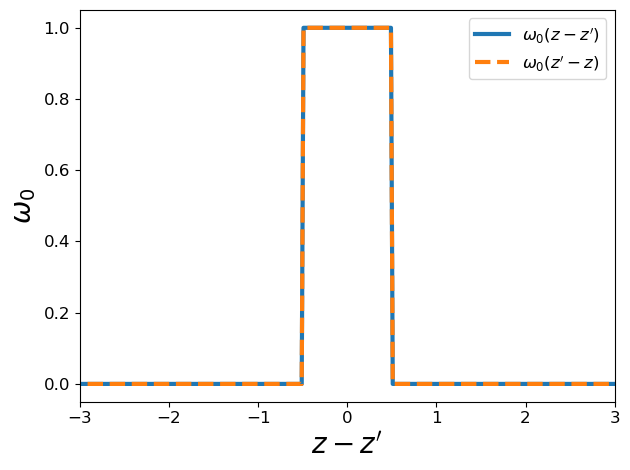

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0

u = z-z_line

omega0 = (np.heaviside(z-z_line+0.5*sigma,1)-np.heaviside(z-z_line-0.5*sigma,1))/sigma
omega02 = (np.heaviside(z_line-z+0.5*sigma,1)-np.heaviside(z_line-z-0.5*sigma,1))/sigma

plt.xlim(-3,3)

plt.plot(u,omega0,label ="$\omega_0(z-z')$",linewidth=3)
plt.plot(u,omega02,linestyle="--",label ="$\omega_0(z'-z)$",linewidth=3)

# Ajustando os tamanhos das fontes nos eixos x e y
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)


plt.legend(fontsize=12)
plt.xlabel("$z-z'$", fontsize=20)
plt.ylabel(r"$\omega_0$", fontsize=20)
plt.tight_layout()
plt.savefig('HowToDo/Figuras/w_even.pdf')
plt.show()

### As for the vector weights

### $\omega(\textbf{r'}-\textbf{r}) = -\omega(\textbf{r}-\textbf{r'}) $

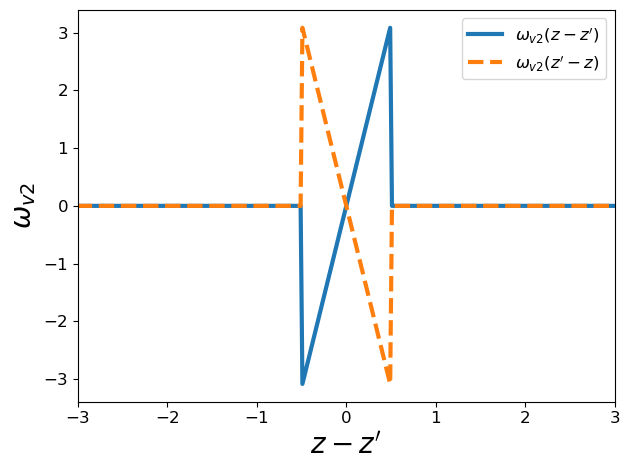

In [ ]:
import numpy as np
from matplotlib import pyplot as plt

sigma=1.
z_line = np.linspace(-10,10,1000)
z = 0

u = z-z_line

omega0 = 2*np.pi*(np.heaviside(z-(z_line)+0.5*sigma,1)-np.heaviside(z-(z_line)-0.5*sigma,1))*(z-z_line)
omega02 = 2*np.pi*(np.heaviside((z_line)-z+0.5*sigma,1)-np.heaviside((z_line)-z-0.5*sigma,1))*(z_line-z)

plt.xlim(-3,3)

plt.plot(u,omega0,label ="$\omega_{v2}(z-z')$",linewidth=3)
plt.plot(u,omega02,linestyle="--",label ="$\omega_{v2}(z'-z)$",linewidth=3)
# Ajustando os tamanhos das fontes nos eixos x e y
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)


#plt.axvline(x=z,color='orange',linestyle="--",)
plt.legend(fontsize=12)
plt.xlabel("$z-z'$", fontsize=20)
plt.ylabel(r"$\omega_{v2}$", fontsize=20)
plt.tight_layout()
plt.savefig('HowToDo/Figuras/w_odd.pdf')
plt.show()

### Considering the $\Phi_{hs}$ presented above, the partial derivation with respect to all $n_\alpha$ and $n_\alpha$ provides

### $\frac{\partial \Phi}{\partial n_0} = - \ln (1-n_3)$

### $\frac{\partial \Phi}{\partial n_1} = \frac{n_2}{1-n_3}$

### $\frac{\partial \Phi}{\partial n_2} = \frac{n_1}{1-n_3}+3(n_2^2-\textbf{n}_2\cdot\textbf{n}_2)
\times \frac{n_3+(1-n_3)^2\ln(1-n_3)}{36\pi n_3^2(1-n_3)^2}$

### $\frac{\partial \Phi}{\partial n_3} = \frac{n_0}{1-n_3}+\frac{n_1n_2-\textbf{n}_1\cdot\textbf{n}_2}{(1-n_3)^2}-(n_2^3-3n_2\textbf{n}_2\cdot\textbf{n}_2) \times \frac{n_3(n_3^2-5n_3+2)+2(1-n_3)^3\ln(1-n_3)}{36\pi n_3^3(1-n_3)^3}$

### $\frac{\partial \Phi}{\partial \textbf{n}_1} = \frac{\textbf{n}_2}{1-n_3}$

### $\frac{\partial \Phi}{\partial \textbf{n}_2} = -\frac{\textbf{n}_1}{1-n_3}-n_2\textbf{n}_2\frac{n_3+(1-n_3)^2\ln(1-n_3)}{6\pi n_3^2 (1-n_3)^2}$

### After presenting these different terms, we will discuss how to perform the first convolution to calculate $n_\alpha$, and then the second convolution to calculate $\frac{\delta F_{hs}}{\delta \rho(r)}$.

### As previously mentioned, the FMT weights will be used in both convolutions. Another critical point is that these weights are only spatially dependent, so when the size of the simulation box is defined, as well as the spacing between points, these weights can be calculated and saved for future use.

### The following is an example of calculating $\omega_\alpha$ in real space (without periodic condition)

In [ ]:
import numpy as np

# Function to evaluate the Heaviside function for each point of the 1D grid
def W_Heaviside(H,Z_vec,Nump,Sigma_ff,dz):
    WH = np.zeros((Nump,Nump))
    for j in range(Nump):
        Zinf = Z_vec[j]-0.5*Sigma_ff
        Zmax = Z_vec[j]+0.5*Sigma_ff
        kinf = max(int(Zinf/dz+1.e-8),0)
        ksup = min(int(Zmax/dz+1.e-8),Nump-1)
        for i in range(Nump):
            if (i >= kinf and i <= ksup):
                WH[i,j] = 1.
            else:
                WH[i,j] = 0.
    return WH

# Function to evaluate the weight for each point of the 1D grid
def Omega_calc(H,Nump,Sigma_ff,Z_vec):
    omega0 = W_Heaviside(H,Z_vec,Nump,Sigma_ff,Z_vec[1]-Z_vec[0])
    omega = np.zeros((Nump,Nump,6))
    omega[:,:,0] = omega0[:,:]/Sigma_ff
    omega[:,:,1] = omega0[:,:]*0.5
    omega[:,:,2] = omega0[:,:]*np.pi*Sigma_ff
    omega[:,:,3] = omega0[:,:]*np.pi
    for j in range(Nump):
        for i in range(Nump):
            aux = ((0.5*Sigma_ff)**2-(Z_vec[i]-Z_vec[j])**2)
            omega[i,j,3] = omega[i,j,3]*aux
            omega[i,j,5] = omega0[i,j]*(Z_vec[i]-Z_vec[j])*2.*np.pi
    omega[:,:,4] = omega[:,:,5]/(2.*np.pi*Sigma_ff)
    return omega

In [ ]:
#%%
#Number of points of the grid
Nump = 500
#Step size on z direction
dz  = 0.01
#Tamanho
H = dz*(Nump-1)
#Spacial vector
Z_vec = np.linspace(0,H,Nump)
# Nondimensionless hard-sphere diameter of the molecule probe
Sigma_ff = 1

In [ ]:
Omega_vec = Omega_calc(H, Nump, Sigma_ff, Z_vec)

### The following code allows you to check the format of the $\omega_\alpha$ weights for each position $z$ within the simulation box.

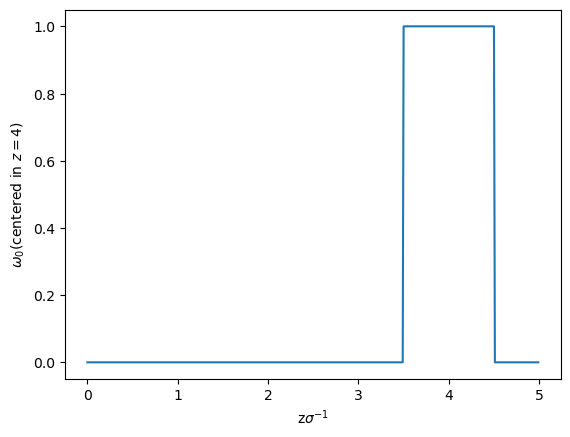

In [ ]:
from matplotlib import pyplot as plt

#Value of Alpha [0,1,2,3,4,5]
# Omega_0 -> 0
# Omega_1 -> 1
# Omega_2 -> 2
# Omega_3 -> 3
# Omega_v1 -> 4
# Omega_v2 -> 5

alpha = 0

#Position of simulation box
z = 4

#point of the position
N_z = int(z/dz)


if (z<H and z>0.0):
    Omega_mid = Omega_vec[:,N_z,int(alpha)]
    plt.plot(Z_vec,Omega_mid)
    plt.xlabel('z$\sigma^{-1}$')
    plt.ylabel('$\omega_'+str(alpha)+'($centered in $ z='+str(z)+')$')
    plt.show()
else:
    print('The value of Z is outside the limit between 0 and '+str(H))

### Let's check the calculation of the weights. The integral of $\omega_3$ evaluated at a point in the simulation box must give the volume of the sphere of diameter $\sigma$.

In [ ]:
#Position of simulation box
z = 1

#point of the position
N_z = int(z/dz)

Omg_test = Omega_vec[:,N_z,3]

import scipy.integrate as integrate

Vol_num = integrate.trapz(Omg_test,Z_vec)

Vol_an = np.pi*Sigma_ff**3/6
Vol_an

print('Numerical volume =',Vol_num)
print('Analytical volume =',Vol_an)

Numerical volume = 0.523546415720739
Analytical volume = 0.5235987755982988


### The following is an example of calculating $\omega_\alpha$ in real space (with periodic condition)

In [ ]:
import numpy as np

# Function to evaluate the Heaviside function for each point of the 1D grid
def W_Heaviside(H,Z_vec,Nump,Sigma_ff,dz):
    WH = np.zeros((Nump,Nump))
    for j in range(Nump):
        Zinf = Z_vec[j]-0.5*Sigma_ff
        Zmax = Z_vec[j]+0.5*Sigma_ff
        kinf = max(int(Zinf/dz+1.e-8),0)
        ksup = min(int(Zmax/dz+1.e-8),Nump-1)
        for i in range(Nump):
            if (i >= kinf and i <= ksup):
                WH[i,j] = 1.
            #adding the periodic condition
            elif (H-Z_vec[i]+Z_vec[j]<0.5*Sigma_ff):
                WH[i,j] = 1.
            elif (H+Z_vec[i]-Z_vec[j]<0.5*Sigma_ff):
                WH[i,j] = 1.
            else:
                WH[i,j] = 0.
    return WH

# Function to evaluate the weight for each point of the 1D grid
def Omega_calc(H,Nump,Sigma_ff,Z_vec):
    omega0 = W_Heaviside(H,Z_vec,Nump,Sigma_ff,Z_vec[1]-Z_vec[0])
    omega = np.zeros((Nump,Nump,6))
    omega[:,:,0] = omega0[:,:]/Sigma_ff
    omega[:,:,1] = omega0[:,:]*0.5
    omega[:,:,2] = omega0[:,:]*np.pi*Sigma_ff
    omega[:,:,3] = omega0[:,:]*np.pi
    for j in range(Nump):
        for i in range(Nump):
            if (H-Z_vec[i]+Z_vec[j]<0.5*Sigma_ff):
                    aux = ((0.5*Sigma_ff)**2-(H-Z_vec[i]+Z_vec[j])**2)
                    aux2 = -(H-Z_vec[i]+Z_vec[j])
            elif (H+Z_vec[i]-Z_vec[j]<0.5*Sigma_ff):
                    aux = ((0.5*Sigma_ff)**2-(H+Z_vec[i]-Z_vec[j])**2)
                    aux2 = H+Z_vec[i]-Z_vec[j]
            else:
                    aux = ((0.5*Sigma_ff)**2-(Z_vec[i]-Z_vec[j])**2)
                    aux2 = (Z_vec[i]-Z_vec[j])
            omega[i,j,3] = omega[i,j,3]*aux
            omega[i,j,5] = omega0[i,j]*aux2*2.*np.pi
    omega[:,:,4] = omega[:,:,5]/(2.*np.pi*Sigma_ff)
    return omega

In [ ]:
#%%
#Number of points of the grid
Nump = 500
#Step size on z direction
dz  = 0.01
#Tamanho
H = dz*(Nump-1)
#Spacial vector
Z_vec = np.linspace(0,H,Nump)
# Nondimensionless hard-sphere diameter of the molecule probe
Sigma_ff = 1

In [ ]:
Omega_vec = Omega_calc(H, Nump, Sigma_ff, Z_vec)

### The following code allows you to check the format of the $\omega_\alpha$ weights for each position $z$ within the simulation box.

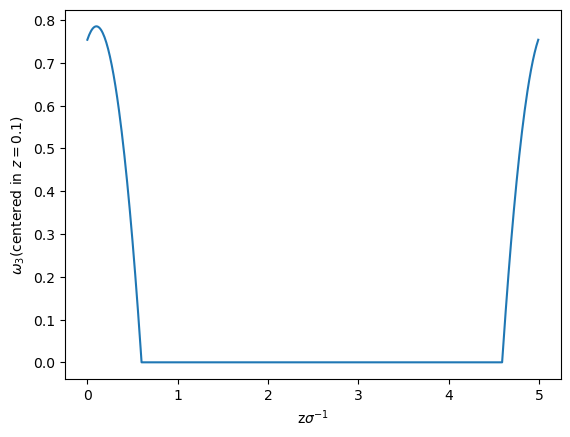

In [ ]:
from matplotlib import pyplot as plt

#Value of Alpha [0,1,2,3,4,5]
# Omega_0 -> 0
# Omega_1 -> 1
# Omega_2 -> 2
# Omega_3 -> 3
# Omega_v1 -> 4
# Omega_v2 -> 5

alpha = 3

#Position of simulation box
z = 0.1

#point of the position
N_z = int(z/dz)


if (z<H and z>0.0):
    Omega_mid = Omega_vec[:,N_z,int(alpha)]
    plt.plot(Z_vec,Omega_mid)
    plt.xlabel('z$\sigma^{-1}$')
    plt.ylabel('$\omega_'+str(alpha)+'($centered in $ z='+str(z)+')$')
    plt.show()
else:
    print('The value of Z is outside the limit between 0 and '+str(H))

### Implementing Convolution

### Convolution in real space

### For the dirac function the rule is:

### $ \int_{-\infty}^{\infty} f(x)\delta(x-a)\text{d}x = f(a) $

### Example:

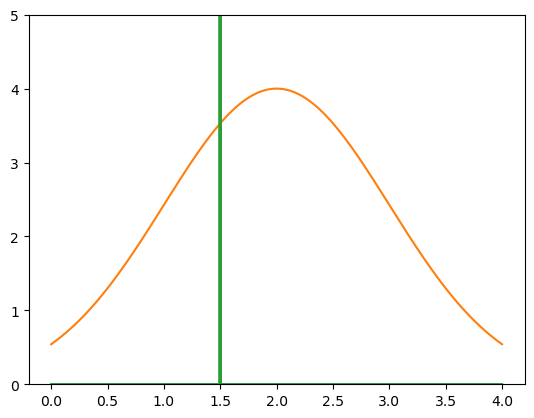

In [ ]:
#grid points
npoints = 1000


x = np.linspace(0,4,npoints)

a = 1.5


#Input of the Heaviside function
y = np.zeros((npoints))
for i in range(npoints):
    y[i] = a - x[i]


#Heaviside Function
theta = np.heaviside(y,1)

#Dirac Function
Dirac = ddx(theta,y)

fx = 4*np.exp(-np.power(x - 2., 2.) / (2 * np.power(1., 2.)))

g = sum(Dirac*fx)*(r[1]-r[0])

func_g = Dirac*fx

plt.plot(x,Dirac)
plt.plot(x,fx)
plt.plot(x,func_g)
plt.ylim(0,5)
plt.show()

In [ ]:
print('value of the integral =',g)
print('f(a) =',4*np.exp(-np.power(a - 2., 2.) / (2 * np.power(1., 2.))))

value of the integral = 0.35259220914552347
f(a) = 3.529987610338382


### Implementing Convolution for the Heaviside step

### $(f \circledast \Theta)(t) = \int_{-\infty}^{\infty}f(\tau)\Theta(t-\tau)\text{d}\tau$

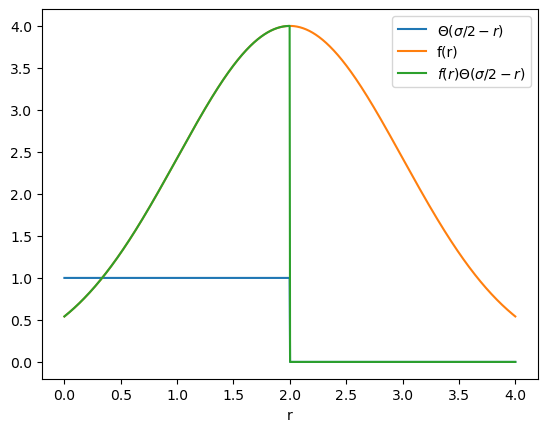

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
from scipy import integrate

#grid points
npoints = 1000

#Molecule radius
Sigma = 4

#space vector
r = np.linspace(0,4,npoints)

#Input of the Heaviside function
x = np.zeros((npoints))
for i in range(npoints):
    x[i] = 0.5*Sigma - r[i]


#Heaviside Function
theta = np.heaviside(x,1)

#density
f = 4*np.exp(-np.power(r - 2., 2.) / (2 * np.power(1., 2.)))

func_g = theta*f

plt.plot(r,theta,label='$\Theta(\sigma/2-r)$')
plt.plot(r,f,label='f(r)')
plt.plot(r,func_g,label='$f(r)\Theta(\sigma/2-r)$')
plt.xlabel("r")
plt.legend()
plt.show()

In [ ]:
integrate.trapz(theta*f,r), integrate.trapz(func_g,r)

(4.7851506068229765, 4.7851506068229765)

### Calculation of $\frac{\delta F_{hs}}{\delta \rho(\textbf{r})}$ from FMT convolutions in real space

### To calculate the weights, it is important to define the conditions of the simulation box

In [ ]:
#%%
#Number of points of the grid
Nump = 500
#Step size on z direction
dz  = 0.01
#Simulation box width (1D)
H = dz*(Nump-1)
#Spacial vector
Z_vec = np.linspace(0,H,Nump)
# Nondimensionless hard-sphere diameter of the molecule probe
Sigma_ff = 1

### The first step is to define the functions for calculating the weights in real space. In this example, we will use weights without a periodic boundary condition.

### In this way we can make the weights ready for use from the expression below

In [ ]:
import numpy as np

# Function to evaluate the Heaviside function for each point of the 1D grid
def W_Heaviside(H,Z_vec,Nump,Sigma_ff,dz):
    WH = np.zeros((Nump,Nump))
    for j in range(Nump):
        Zinf = Z_vec[j]-0.5*Sigma_ff
        Zmax = Z_vec[j]+0.5*Sigma_ff
        kinf = max(int(Zinf/dz+1.e-8),0)
        ksup = min(int(Zmax/dz+1.e-8),Nump-1)
        for i in range(Nump):
            if (i >= kinf and i <= ksup):
                WH[i,j] = 1.
            else:
                WH[i,j] = 0.
    return WH

# Function to evaluate the weight for each point of the 1D grid
def Omega_calc(H,Nump,Sigma_ff,Z_vec):
    omega0 = W_Heaviside(H,Z_vec,Nump,Sigma_ff,Z_vec[1]-Z_vec[0])
    omega = np.zeros((Nump,Nump,6))
    omega[:,:,0] = omega0[:,:]/Sigma_ff
    omega[:,:,1] = omega0[:,:]*0.5
    omega[:,:,2] = omega0[:,:]*np.pi*Sigma_ff
    omega[:,:,3] = omega0[:,:]*np.pi
    for j in range(Nump):
        for i in range(Nump):
            aux = ((0.5*Sigma_ff)**2-(Z_vec[i]-Z_vec[j])**2)
            omega[i,j,3] = omega[i,j,3]*aux
            omega[i,j,5] = omega0[i,j]*(Z_vec[i]-Z_vec[j])*2.*np.pi
    omega[:,:,4] = omega[:,:,5]/(2.*np.pi*Sigma_ff)
    return omega

In [ ]:
Omega_vec = Omega_calc(H, Nump, Sigma_ff, Z_vec)

### With the weights, we can define a function to calculate each $n_{\alpha}$ for each point on our grid. This is the first convolution to be solved:

### $n_{\alpha}(z) = \int \rho(z')\omega(z-z')dz'$

In [ ]:
def calc_N(H,Omega_vec,density,Nump,dz,Sigma_ff,Z_vec):
    N_alpha = np.zeros((Nump,6))
    conv = np.zeros((Nump,6))
    for n in range(6):
        for j in range(Nump):
            Zinf = Z_vec[j]-0.5*Sigma_ff
            Zmax = Z_vec[j]+0.5*Sigma_ff
            kinf = max(int(Zinf/dz+1.e-8),0)
            ksup = min(int(Zmax/dz+1.e-8),Nump-1)
            for i in range(Nump):
                if i==kinf or i==ksup:
                    conv[j,n] += 0.5*Omega_vec[i,j,n]*density[i]
                else:
                    conv[j,n] += Omega_vec[i,j,n]*density[i]
    N_alpha = conv*dz
    return N_alpha

### Here

### $n_{0}$ -> N_alpha[:,0]
### $n_{1}$ -> N_alpha[:,1]
### $n_{2}$ -> N_alpha[:,2]
### $n_{3}$ -> N_alpha[:,3]
### $n_{v1}$ -> N_alpha[:,4]
### $n_{v2}$ -> N_alpha[:,5]

### With the values of $n_{\alpha}$ we can calculate the $\frac{\partial \phi_{hs}(r)}{\partial n_\alpha(r)}$:

In [ ]:
def d_Phi(H,Omega_vec,Nump,rho_vec,dz,Sigma_ff,Z_vec):
    N_fmt = calc_N(H,Omega_vec,rho_vec,Nump,dz,Sigma_ff,Z_vec)
    dPhi = np.zeros((Nump,6))
    for i in range(Nump):
        if N_fmt[i,3]> 1.e-8:
            Temp = 1.-N_fmt[i,3]
            dPhi[i,0] = -np.log(Temp)
            dPhi[i,1] = N_fmt[i,2]/Temp
            dPhi[i,2] = (N_fmt[i,1]/Temp)+(np.log(Temp)/N_fmt[i,3]+
                        1.0/Temp**2)*(N_fmt[i,2]**2-
                        N_fmt[i,5]**2)/(12.0*np.pi*N_fmt[i,3])
            dPhi[i,3] = N_fmt[i,0]/Temp+(N_fmt[i,1]*N_fmt[i,2]-N_fmt[i,4]*
                    N_fmt[i,5])/Temp**2-(np.log(Temp)/(18.0*np.pi*
                    N_fmt[i,3]**3)+1.0/(36.0*np.pi*N_fmt[i,3]**2*Temp)+
                    (1.0-3.0*N_fmt[i,3])/(36.0*np.pi*N_fmt[i,3]**2*
                    Temp**3))*(N_fmt[i,2]**3-3.0*N_fmt[i,2]*N_fmt[i,5]**2)
            dPhi[i,4] = -N_fmt[i,5]/Temp
            dPhi[i,5] = -N_fmt[i,4]/Temp-(np.log(Temp)/N_fmt[i,3]+1.0
                    /Temp**2)*N_fmt[i,2]*N_fmt[i,5]/(6.0*np.pi*N_fmt[i,3])
    return dPhi

### And with the values of $\frac{\partial \phi_{hs}(r)}{\partial n_\alpha(r)}$ we can calculate the second convolution:

### $\frac{\delta F_{hs}[\rho(\textbf{z})]}{\delta \rho(\textbf{z})} = \int \frac{\partial \phi(\textbf{z'})}{\partial n_\alpha (\textbf{z'})} \omega(z-z')dz'$

In [ ]:
def calc_dFHS(H,Omega_vec,rho_vec,Nump,dz,T,Sigma_ff,Z_vec):
    dPhi = d_Phi(H,Omega_vec,Nump,rho_vec,dz,Sigma_ff,Z_vec)
    conv = np.zeros((Nump,6))
    FHS = np.zeros((Nump))
    for n in range(6):
        if n == 4 or n == 5:
            Omega_vec[:,:,n] *= -1
        for j in range(Nump):
            Zinf = Z_vec[j]-0.5*Sigma_ff
            Zmax = Z_vec[j]+0.5*Sigma_ff
            kinf = max(int(Zinf/dz+1.e-8),0)
            ksup = min(int(Zmax/dz+1.e-8),Nump-1)
            for i in range(Nump):
                if i==kinf or i==ksup:
                    conv[j,n] += 0.5*Omega_vec[i,j,n]*dPhi[i,n]
                else:
                    conv[j,n] += Omega_vec[i,j,n]*dPhi[i,n]
    for i in range(Nump):
        FHS[i] = np.sum(conv[i,:])*dz
    return FHS*T

### The value for the derivative of the free energy can be validated by the value of the chemical potential when we look at a point in the middle of a large simulation box.

In [ ]:
T = 3.

rho_H = 0.5

EtaH = np.pi*rho_H*Sigma_ff**3/6.0

mu_HS = T*(EtaH*(8.0-9.0*EtaH+3.*EtaH**2)/(1.-EtaH)**3)

print(mu_HS)

11.420356269613952


In [ ]:
rho_vec = np.zeros((Nump))+rho_H

dFhs = calc_dFHS(H, Omega_vec, rho_vec, Nump, dz, T, Sigma_ff, Z_vec)

print(dFhs[int(Nump/2)])

11.419516554464387


### This code can be accelerated with JIT (Just in Time) from the Numba toolbox, optimizing the loops.

In [ ]:
#%%
#Number of points of the grid
Nump = 500
#Step size on z direction
dz  = 0.01
#Simulation box width (1D)
H = dz*(Nump-1)
#Spacial vector
Z_vec = np.linspace(0,H,Nump)
# Nondimensionless hard-sphere diameter of the molecule probe
Sigma_ff = 1

import numpy as np
from numba import jit


# Function to evaluate the Heaviside function for each point of the 1D grid
@jit(nopython=True)
def W_Heaviside(H,Z_vec,Nump,Sigma_ff,dz):
    WH = np.zeros((Nump,Nump))
    for j in range(Nump):
        Zinf = Z_vec[j]-0.5*Sigma_ff
        Zmax = Z_vec[j]+0.5*Sigma_ff
        kinf = max(int(Zinf/dz+1.e-8),0)
        ksup = min(int(Zmax/dz+1.e-8),Nump-1)
        for i in range(Nump):
            if (i >= kinf and i <= ksup):
                WH[i,j] = 1.
            else:
                WH[i,j] = 0.
    return WH

# Function to evaluate the weight for each point of the 1D grid
@jit(nopython=True)
def Omega_calc(H,Nump,Sigma_ff,Z_vec):
    omega0 = W_Heaviside(H,Z_vec,Nump,Sigma_ff,Z_vec[1]-Z_vec[0])
    omega = np.zeros((Nump,Nump,6))
    omega[:,:,0] = omega0[:,:]/Sigma_ff
    omega[:,:,1] = omega0[:,:]*0.5
    omega[:,:,2] = omega0[:,:]*np.pi*Sigma_ff
    omega[:,:,3] = omega0[:,:]*np.pi
    for j in range(Nump):
        for i in range(Nump):
            aux = ((0.5*Sigma_ff)**2-(Z_vec[i]-Z_vec[j])**2)
            omega[i,j,3] = omega[i,j,3]*aux
            omega[i,j,5] = omega0[i,j]*(Z_vec[i]-Z_vec[j])*2.*np.pi
    omega[:,:,4] = omega[:,:,5]/(2.*np.pi*Sigma_ff)
    return omega

@jit(nopython=True)
def calc_N(H,Omega_vec,density,Nump,dz,Sigma_ff,Z_vec):
    N_alpha = np.zeros((Nump,6))
    conv = np.zeros((Nump,6))
    for n in range(6):
        for j in range(Nump):
            Zinf = Z_vec[j]-0.5*Sigma_ff
            Zmax = Z_vec[j]+0.5*Sigma_ff
            kinf = max(int(Zinf/dz+1.e-8),0)
            ksup = min(int(Zmax/dz+1.e-8),Nump-1)
            for i in range(Nump):
                if i==kinf or i==ksup:
                    conv[j,n] += 0.5*Omega_vec[i,j,n]*density[i]
                else:
                    conv[j,n] += Omega_vec[i,j,n]*density[i]
    N_alpha = conv*dz
    return N_alpha

@jit(nopython=True)
def d_Phi(H,Omega_vec,Nump,rho_vec,dz,Sigma_ff,Z_vec):
    N_fmt = calc_N(H,Omega_vec,rho_vec,Nump,dz,Sigma_ff,Z_vec)
    dPhi = np.zeros((Nump,6))
    for i in range(Nump):
        if N_fmt[i,3]> 1.e-8:
            Temp = 1.-N_fmt[i,3]
            dPhi[i,0] = -np.log(Temp)
            dPhi[i,1] = N_fmt[i,2]/Temp
            dPhi[i,2] = (N_fmt[i,1]/Temp)+(np.log(Temp)/N_fmt[i,3]+
                        1.0/Temp**2)*(N_fmt[i,2]**2-
                        N_fmt[i,5]**2)/(12.0*np.pi*N_fmt[i,3])
            dPhi[i,3] = N_fmt[i,0]/Temp+(N_fmt[i,1]*N_fmt[i,2]-N_fmt[i,4]*
                    N_fmt[i,5])/Temp**2-(np.log(Temp)/(18.0*np.pi*
                    N_fmt[i,3]**3)+1.0/(36.0*np.pi*N_fmt[i,3]**2*Temp)+
                    (1.0-3.0*N_fmt[i,3])/(36.0*np.pi*N_fmt[i,3]**2*
                    Temp**3))*(N_fmt[i,2]**3-3.0*N_fmt[i,2]*N_fmt[i,5]**2)
            dPhi[i,4] = -N_fmt[i,5]/Temp
            dPhi[i,5] = -N_fmt[i,4]/Temp-(np.log(Temp)/N_fmt[i,3]+1.0
                    /Temp**2)*N_fmt[i,2]*N_fmt[i,5]/(6.0*np.pi*N_fmt[i,3])
    return dPhi


@jit(nopython=True)
def calc_dFHS(H,Omega_vec,rho_vec,Nump,dz,T,Sigma_ff,Z_vec):
    dPhi = d_Phi(H,Omega_vec,Nump,rho_vec,dz,Sigma_ff,Z_vec)
    conv = np.zeros((Nump,6))
    FHS = np.zeros((Nump))
    for n in range(6):
        if n == 4 or n == 5:
            Omega_vec[:,:,n] *= -1
        for j in range(Nump):
            Zinf = Z_vec[j]-0.5*Sigma_ff
            Zmax = Z_vec[j]+0.5*Sigma_ff
            kinf = max(int(Zinf/dz+1.e-8),0)
            ksup = min(int(Zmax/dz+1.e-8),Nump-1)
            for i in range(Nump):
                if i==kinf or i==ksup:
                    conv[j,n] += 0.5*Omega_vec[i,j,n]*dPhi[i,n]
                else:
                    conv[j,n] += Omega_vec[i,j,n]*dPhi[i,n]
    for i in range(Nump):
        FHS[i] = np.sum(conv[i,:])*dz
    return FHS*T


Omega_vec = Omega_calc(H, Nump, Sigma_ff, Z_vec)
dFhs = calc_dFHS(H, Omega_vec, rho_vec, Nump, dz, T, Sigma_ff, Z_vec)

print(dFhs[int(Nump/2)])

11.419516554464387


## Convolution in Fourier Space

### To solve the FMT convolution in Fourier space, the first step is to take the variables into Fourier space. This procedure can be done analytically or using the FFT strategy.

### We can use several libraries in Python to perform the FFT conversion; in this review, we will present one of them. However, it is preferable to transform the weights analytically into fourier space for two reasons. The first is to reduce the number of operations within the loop in which the DFT is converged. The second reason is the noise associated with the FFT transformation, which, when applied to both the weights and the other variables, which have no analytical solution, forces the user to use a very refined mesh to find a more accurate convolution value.

### Therefore, in the literature, the suggestion is to use the weights in Fourier space analytically, which will be presented now.

### There are different ways to define the Fourier transform, a more generic way to present this transformation is in the following equation:

### $\sqrt{\frac{|b|}{(2 \pi )^{1-a}}}\int_{-\infty}^{\infty}f(t)e^{i b k t}\text{d}t$

### $a$ and $b$ are parameters that can take on different values depending on the definition. Some commonly used examples are

### $(a,b)$ = $(0,1)$,$(1,-1)$,$(-1,1)$ and $(0,-2\pi)$

### Here, we will use $(0,-2\pi)$ since, by default, it is used in the packages that will be presented.

### With these values, the transformation will be:

### $\int_{-\infty}^{\infty}f(t)e^{-2 \pi i k t}\text{d}t$

### To get the FMT weights for our one-dimensional problem, we apply this operator to the weights $\omega_{\alpha}(z-z')$.

### If $u = z - z'$

### For the $\omega_0(u)$:

### $\int_{-\infty}^{\infty}\frac{\Theta(u+0.5\sigma_i)-\Theta(u-0.5\sigma_i)}{\sigma_i}e^{-2 \pi i k u}\text{d}u = \frac{\sin(\sigma k \pi)}{\sigma k \pi}$

### and with

### $\lim_{k \to 0} \frac{\sin(\sigma k \pi)}{\sigma k \pi} = 1$

### For the $\omega_1(u)$:

### $\int_{-\infty}^{\infty}\frac{\Theta(u+0.5\sigma_i)-\Theta(u-0.5\sigma_i)}{2}e^{-2 \pi i k u}\text{d}u = \frac{\sin(\sigma k \pi)}{2 k \pi}$

### and with

### $\lim_{k \to 0} \frac{\sin(\sigma k \pi)}{(2 k \pi)} = 0.5 \sigma$

### For the $\omega_2(u)$:

### $\int_{-\infty}^{\infty}\pi\sigma\left(\Theta(u+0.5\sigma_i)-\Theta(u-0.5\sigma_i)\right) e^{-2 \pi i k u}\text{d}u = \frac{\sigma \sin(\sigma k \pi)}{k}$

### and with

### $\lim_{k \to 0} \frac{\sigma \sin(\sigma k \pi)}{k} = \pi \sigma^2$

### For the $\omega_3(u)$:

### $\int_{-\infty}^{\infty} \pi\left(\Theta(u+0.5\sigma_i)-\Theta(u-0.5\sigma_i)\right)
\times\left[\left(\frac{\sigma}{2} \right)^2 - (u)^2\right] e^{-2 \pi i k u}\text{d}u = $
### $\frac{\sin(\sigma k \pi)}{2 k^3 \pi^2}-\frac{\sigma \cos(\sigma k \pi)}{2 k^2 \pi}$

### and with:

### $\lim_{k\to 0}\frac{\sin(\sigma k \pi)}{2 k^3 \pi^2}-\frac{\sigma \cos(\sigma k \pi)}{2 k^2 \pi} = \frac{\pi \sigma^3}{6}$

### For the $\omega_{v1}(u)$:

### $\int_{-\infty}^{\infty} u \hat{e}_u\frac{\left(\Theta(u+0.5\sigma_i)-\Theta(u-0.5\sigma_i)\right)}{\sigma}  e^{-2 \pi i k u}\text{d}u = -\frac{i \left(\sin(\sigma k \pi)-\sigma k \pi\cos(\sigma k \pi) \right)}{2 \sigma k^2 \pi^2}$

### and with:

### $\lim_{k\to 0}\frac{i \left(\sin(\sigma k \pi)-\sigma k \pi\cos(\sigma k \pi) \right)}{2 \sigma k^2 \pi^2}=0 $

### For the $\omega_{v2}(u)$:

### $\int_{-\infty}^{\infty} 2 \pi u \hat{e}_u \left(\Theta(u+0.5\sigma_i)-\Theta(u-0.5\sigma_i)\right)  e^{-2 \pi i k u}\text{d}u = -\frac{i \left(\sin(\sigma k \pi)-\sigma k \pi\cos(\sigma k \pi) \right)}{k^2 \pi}$

### and with:

### $\lim_{k\to 0}\frac{i \left(\sin(\sigma k \pi)-\sigma k \pi\cos(\sigma k \pi) \right)}{k^2 \pi}=0 $

### As with real-space weights, you can define a function for the weights so that they are calculated at the beginning of the algorithm and saved and reused during the DFT convergence process.

### The following is an example function for calculating weights in Fourier space:

In [ ]:
def W_FMT_calc(H,Nump,dhs):

    #kf is the Discrete Fourier Transform sample frequencies
    kf = np.fft.fftfreq(Nump,d=H/(Nump-1))
    #Hard sphere Radius
    rhs = 0.5*dhs
    #Weights of the FMT
    w_fmt = np.zeros((Nump,6),dtype=np.complex128)

    for i in range(Nump):
        if (i>0):
            w_fmt[i,0] = 2.0*rhs*np.sin(2.0*np.pi*rhs*kf[i])/(kf[i]*4.*np.pi*rhs**2)
            w_fmt[i,1] = 2.0*rhs*np.sin(2.0*np.pi*rhs*kf[i])/(kf[i]*4.*np.pi*rhs)
            w_fmt[i,2] = 2.0*rhs*np.sin(2.0*np.pi*rhs*kf[i])/kf[i]
            w_fmt[i,3] = (np.sin(2.0*rhs*kf[i]*np.pi)-
                        2.0*rhs*np.pi*kf[i]*np.cos(2.0*rhs*kf[i]*np.pi))/(2.*kf[i]**3*np.pi**2)
            w_fmt[i,4] = -(-2j*rhs*kf[i]*np.pi*np.cos(2*rhs*kf[i]*np.pi) +
                          1j*np.sin(2*rhs*kf[i]*np.pi))/(np.pi*kf[i]**2)/(4.*np.pi*rhs)
            w_fmt[i,5] = -(-2j*rhs*kf[i]*np.pi*np.cos(2*rhs*kf[i]*np.pi) +
                          1j*np.sin(2*rhs*kf[i]*np.pi))/(np.pi*kf[i]**2)
        else:
            w_fmt[i,0] = 1.0
            w_fmt[i,1] = rhs
            w_fmt[i,2] = 4.0*rhs**2*np.pi
            w_fmt[i,3] = 4.0*np.pi*rhs**3/3.0
            w_fmt[i,4] = 0.0
            w_fmt[i,5] = 0.0

    return w_fmt

### Here the inputs are $H$, $Nump$, $dhs$ which represent the size of the box, the hard-sphere diameter

### Validation of $\omega_3$. Bringing back to real space.

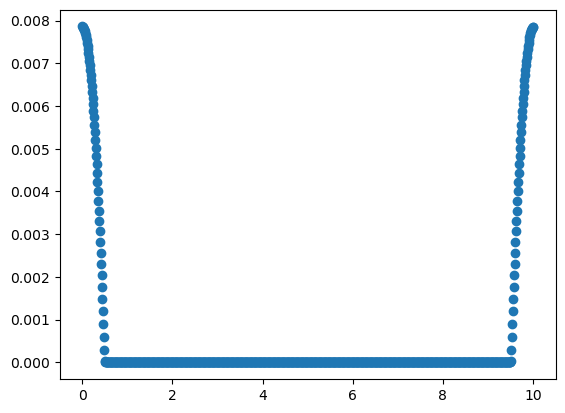

In [ ]:
H = 10
Nump = 1000
dhs = 1.0

z = np.linspace(0,H,Nump)

w_fmt = W_FMT_calc(H,Nump,dhs)

w3 = w_fmt[:,3]

rho_teste = np.zeros((int(Nump)))+1.0

from scipy.fft import fft, ifft

rho_fft = fft(rho_teste)

Conv_test_F = ifft(rho_fft*w3)

result_convolution =  np.real(Conv_test_F)


WFMTreal = np.real(ifft(w3))

from matplotlib import pyplot as plt
plt.scatter(z,WFMTreal)
#plt.xlim(0,10)
plt.show()

### Having the weights in Fourier space, it's possible to calculate the $n_\alpha$'s. To transform the density vector $\rho$ into Fourier space, one can use the fft functions from the scipy.fft package. Similarly, to obtain the inverse transform, the ifft function from the same package can be employed.

### Below is a routine that takes the weight vector (w\_fmt) already in Fourier space, converts the density vectors to Fourier space, and performs the multiplication. Finally, the $n_\alpha$'s are converted back to real space.

In [ ]:
#Importing FFT and Inverse FFT functions
from scipy.fft import fft, ifft
#Importing FFT and Inverse FFT functions
def calc_N(w_fmt, rho, Nump):
    rho_fft = fft(rho)

    N_fft = np.zeros((Nump, 6), dtype=np.complex128)
    N_real = np.zeros((Nump, 6))

    for i in range(6):
        N_fft[:, i] = w_fmt[:, i]*rho_fft

    for i in range(6):
        N_real[:, i] = ifft(N_fft[:, i]).real

    return N_real

### With the $n_\alpha$'s in real space, the calculation of $\partial \phi / \partial n_\alpha$ can be done the same way as presented in the previous section.

### Thus, to complete the calculation of $\delta F_{hs}/ \delta \rho$, $\partial \phi / \partial n_\alpha$ is converted to Fourier space and multiplied by the weight vector already in Fourier space, as shown in the following code.

In [ ]:
def calc_dFHS(H,w_fmt,rho_vec,Nump):
    dPhi = d_Phi(H,w_fmt,Nump,rho_vec)

    dPhi_fft = np.zeros((Nump,6),dtype=complex)
    dFHS_fft = np.zeros((Nump,6),dtype=complex)
    dFHS_real = np.zeros((Nump,6))


    for i in range(6):
        dPhi_fft[:,i] = fft(dPhi[:,i])
        if i == 4 or i == 5:
            w_fmt[:,i] *= -1
        dFHS_fft[:,i] = w_fmt[:,i]*dPhi_fft[:,i]
        dFHS_real[:,i] =  np.real(np.fft.ifftn(dFHS_fft[:,i]))

    dFHS = np.zeros((Nump))

    for i in range(Nump):
        dFHS[i] = np.sum(dFHS_real[i,:])

    return dFHS

### Where dPhi represents $\partial \phi / \partial n_\alpha$, dPhi\_fft is its value in Fourier space, dFHS\_fft is $\delta F_{hs}/ \delta \rho$ in Fourier space, while dFHS\_real is its value back in real space. With these values, performing the iterative method presented below is possible.

## Now we can rewrite the DFT algorithm now accounting for the Hard-Spheres contribution

### First, calculate the bulk density considering P and T in volume and some properties of the molecules

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
from scipy.optimize import minimize
from numba import jit

#Temperature of the system [K]
T = 100
#Volumar Pressure [Bar]
P = 11
#LJ Properties of the molecule probe
Sigma_ff = 3 #A
d_HS = Sigma_ff
Eps_kb = 100 #K
#LJ Properties of the wall
E_eff = 100
Sigma_sf = 2.5
#Boltzmann constant
kb = 1.3806488e-23

#Normalization
T = T/Eps_kb
P = ((P*1.e5)/(kb*E_eff)*(Sigma_ff*1.e-10)**3)
E_eff = E_eff/Eps_kb*(Sigma_ff*Sigma_ff)
Eps_kb = Eps_kb/Eps_kb
d_HS = d_HS/Sigma_ff
Sigma_sf = Sigma_sf/Sigma_ff
Sigma_ff = Sigma_ff/Sigma_ff
rc_MF = 5.*Sigma_ff

#Number of points of the grid
H = 5                                # [Pore width - Angstroms]
dz = 0.01                              # [distance between grid points - Angstroms]
Nump = int(H/dz)+1              #[Number of points]
#Step size on z direction
#Spacial vector
Z_vec = np.linspace(0,H,Nump)

#Calculating Rho_H

def Fobj_Rho(rho0):
    #Initial guess
    Eta = np.pi*rho0*Sigma_ff**3/6.
    #Carnahan–Starling equation of state
    P_cs = T*rho0*(1+Eta+Eta**2-Eta**3)/(1-Eta)**3
    return (P_cs-P)**2

min_val = minimize(Fobj_Rho, 1.e-7, method='BFGS')

rho_H = min_val.x
print(rho_H)

[0.02059827]


### Calculate the volumetric chemical potential

In [ ]:
#Chemical-Potential calculation

#Ideal-Gas contribution
mu_ID = T*np.log(rho_H)

EtaH = np.pi*rho_H*Sigma_ff**3/6.0

mu_HS = T*(EtaH*(8.0-9.0*EtaH+3.*EtaH**2)/(1.-EtaH)**3)

mu_H = mu_ID+mu_HS

print(mu_H)